# Spleen Negative Binomial Results

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import sparse, optimize, stats
from scipy.special import beta as BF
from matplotlib import colors, cm

## Load data

### RST

In [4]:
df3 = pd.read_pickle('./spleen_data/for_paper/balbc1_data.pkl')
df = df3[['X1_adjusted', 'Y1_adjusted', 'rev_cell_type', 'color']]
df.columns = [ 'X', 'Y', 'Cluster_remap', 'cell_type_color']
df.head()

,X,Y,Cluster_remap,cell_type_color
0,15,221,15,#0087ff
3,12,444,2,#00e9ff
7,16,367,5,#00ff50
12,7,625,26,#ffff00
15,12,464,5,#00ff50


### IST (Full size)

In [6]:
A_composite = sparse.load_npz('./spleen_data/for_paper/stitched_graph_noblank.npz')
B_composite = np.load('./spleen_data/for_paper/B_full_image_heuristic_4.npy')
C_composite_trim = np.load('./spleen_data/for_paper/C_composite_trim.npy')

In [7]:
type_dict = dict()
for i in range(0, B_composite.shape[0]):

    for j in range(0, B_composite.shape[1]):
        if B_composite[i, j] == 1:
            type_dict[i] = j
            
position_dict = dict()
for i in range(0, C_composite_trim.shape[0]):
    position_dict[i] = C_composite_trim[i, :]

point_list = [position_dict[i] for i in range(0, C_composite_trim.shape[0])]
color_list = ["#ffc500","#12ff00","#00e9ff","#005600","#ff3100","#00ff50","#75ff00","#0056ff","#ff0000","#ffafaf","#fff600","#a000ff","#00ffb2","#6f00ff","#ff00fb","#0087ff","#0d00ff","#0024ff","#ff6200","#3e00ff","#d100ff","#00ff81","#00b8ff","#00ffe4","#ff9400","#a6ff00","#ffff00","#000000"]
colors = [color_list[type_dict[i]] for i in range(0, B_composite.shape[0])]

In [8]:
types = np.array(list(type_dict.values())).astype(int)
arr = np.vstack(([i for i in range(0, B_composite.shape[0])], C_composite_trim[:,0], C_composite_trim[:,1], types)).T
df_ist = pd.DataFrame(arr, columns = ['cellID', 'X', 'Y', 'Cluster_remap'])
df_ist['cell_type_color'] = np.array(colors)

In [9]:
df_ist.head()

,cellID,X,Y,Cluster_remap,cell_type_color
0,0.0,0.000000,0.0,19.0,#3e00ff
1,1.0,23.714323,0.0,26.0,#ffff00
2,2.0,45.522330,0.0,5.0,#00ff50
3,3.0,69.022555,0.0,14.0,#ff00fb
4,4.0,91.674403,0.0,26.0,#ffff00


## Visualization

In [7]:
max(df_ist['Y'])

7000.896945660249

<Figure size 432x288 with 0 Axes>

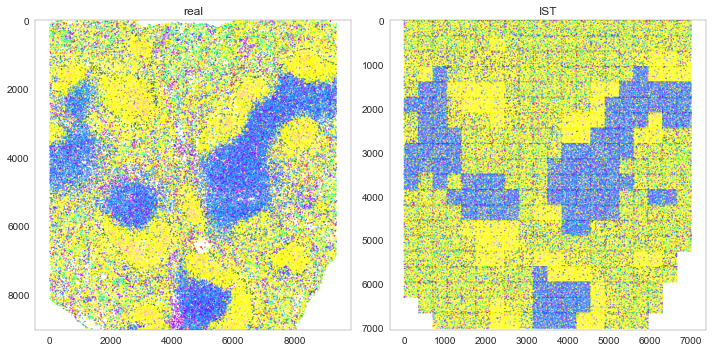

In [46]:
import matplotlib
from matplotlib import cm, colors
import matplotlib.pyplot as plt

matplotlib.rcParams.update({'axes.linewidth': 0.25,
                            'xtick.major.size': 2,
                            'xtick.major.width': 0.25,
                            'ytick.major.size': 2,
                            'ytick.major.width': 0.25,
                            'pdf.fonttype': 42,
                            'font.sans-serif': 'Arial'})

toi = None

def plot_toi(df, df_ist, toi, outdir=None, filename=None):
    
    if toi == None:
        df_toi = df
        df_ist_toi = df_ist
    else:
        df_toi = df[df['Cluster_remap'] == toi]
        df_ist_toi = df_ist[df_ist['Cluster_remap'] == toi]
    
    plt.clf()
    sns.set_style('white')
    fix, (ax1, ax2) = plt.subplots(1,2, figsize = (10,5))
    ax1.scatter(df_toi['X'], df_toi['Y'], color=df_toi['cell_type_color'], marker='o', s=0.1)
    ax1.set_title(r'real')
    ax1.set_ylim(9050,0)
    
    
    ax2.scatter(df_ist_toi['X'], df_ist_toi['Y'], color=df_ist_toi['cell_type_color'], marker='o', s=0.1)
    ax2.set_title(r'IST')
    ax2.set_ylim(7050,0)
    #ax2.set_xlim(0,4000)
    #plt.gca().invert_yaxis()
    #plt.savefig('../fig/full_osmFISH_data_real_IST_sidebyside.pdf')
    plt.tight_layout()
    
    
    if outdir != None:
        plt.savefig(outdir + filename)
    plt.show()
plot_toi(df, df_ist, toi, outdir='./spleen_data/figures/', filename='Figure2C_5.pdf')
#plot_toi(df, df_ist, toi)

In [10]:
label_dict = {0: 'plasma cells',
            1: 'noid',
            2: 'megakaryocytes',
            3: 'marginal zone mphs',
            4: 'granulocytes',
            5: 'erythroblasts',
            6: 'capsule',
            7: 'CD4(+)MHCII(+)',
            8: 'NK cells',
            9: 'FDCs',
            10: 'F4/80(+) mphs',
            11: 'ERTR7(+) stroma',
            12: 'CD4(-)CD8(+)cDC',
            13: 'CD8(+) T cells',
            14: 'CD4(+)CD8(-)cDC',
            15: 'CD4(+) T cells',
            16: 'CD3(+) other markers (-)',
            17: 'CD31(hi) vascular',
            18: 'CD4(-)CD8(-) cDC',
            19: 'CD106(+)CD16/32(+)CD31(-)Ly6C(-) stroma',
            20: 'CD106(+)CD16/32(-)Ly6C(+)CD31(+)',
            21: 'CD106(+)CD16/32(+)CD31(+) stroma',
            22: 'CD106(-)CD16/32(+)Ly6C(+)CD31(-)',
            23: 'CD106(-)CD16/32(-)Ly6C(+)CD31(+) stroma',
            24: 'B220(+) DN T cells',
            25: 'CD11c(+) B cells',
            26: 'B cells'}

<Figure size 432x288 with 0 Axes>

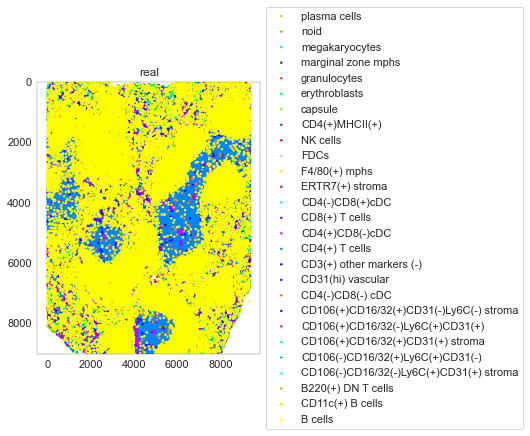

In [49]:
import matplotlib
from matplotlib import cm, colors
import matplotlib.pyplot as plt

matplotlib.rcParams.update({'axes.linewidth': 0.25,
                            'xtick.major.size': 2,
                            'xtick.major.width': 0.25,
                            'ytick.major.size': 2,
                            'ytick.major.width': 0.25,
                            'pdf.fonttype': 42,
                            'font.sans-serif': 'Arial'})
plt.clf()
sns.set_style('white')
fig, (ax1) = plt.subplots(1,1, figsize = (5,5))
for toi in np.sort(df['Cluster_remap'].unique()):
    if toi == None:
        df_toi = df
        df_ist_toi = df_ist
    else:
        df_toi = df[df['Cluster_remap'] == toi]
        df_ist_toi = df_ist[df_ist['Cluster_remap'] == toi]
        label = label_dict[toi]
   
    ax1.scatter(df_toi['X'], df_toi['Y'], color=df_toi['cell_type_color'], marker='o', s=2, label=label)
    ax1.set_title(r'real')
    ax1.set_ylim(9050,0)

# Shrink current axis by 20%
box = ax1.get_position()
ax1.set_position([box.x0, box.y0, box.width * 0.8, box.height])

# Put a legend to the right of the current axis
ax1.legend(loc='center left', bbox_to_anchor=(1, 0.5))

#plt.legend()
plt.savefig('./spleen_data/figures/spleen_legend.pdf')

## Sampling Experiments

### Helper Functions

In [11]:
def build_assignment_matrix(attribute_dict, n_cell_types):
    data = list(attribute_dict.items())
    data = np.array(data)  # Assignment matrix

    B = np.zeros((data.shape[0], n_cell_types))  # Empty matrix

    for i in range(0, data.shape[0]):
        t = int(data[i, 1])
        B[i, t] = 1

    return B

def calculate_FOV_size(sampling_frac, min_x, max_x, min_y, max_y):
    area = (max_x - min_x) * (max_y - min_y)
    sampling_area = sampling_frac * area
    FOV_dim = np.round(np.sqrt(sampling_area))
    return FOV_dim

def random_FOV(FOV_dim, df, min_x, max_x, min_y, max_y):
    x_start = np.random.randint(min_x, max_x - FOV_dim)
    y_start = np.random.randint(min_y, max_y - FOV_dim)
    
    x_filtered = df[(df['X'] > x_start) & (df['X'] < x_start + FOV_dim)]
    random_FOV = x_filtered[(x_filtered['Y'] > y_start) & (x_filtered['Y'] < y_start + FOV_dim)]
    
    return random_FOV

def calculate_p_in_fov(fov, n_cell_types):
    types_in_fov = fov['Cluster_remap'].tolist()
    #print(types_in_fov)
    attribute_dict = dict(zip(fov.index, types_in_fov))
    B = build_assignment_matrix(attribute_dict, n_cell_types)
    return np.divide(np.sum(B, axis=0), B.shape[0])

def estimate_beta_from_FOV(df, fov_dim, type_of_interest, n_fov, x_min, x_max, y_min, y_max, n_cell_types):
    p_list = []
    i = 0
    ns = []
    while i < n_fov:
        fov = random_FOV(fov_dim, df, x_min, x_max, y_min, y_max)
        if len(fov) > 10:
            # because we don't define the boundary of the TISSUE just the boundary of the image
            # you could draw an fov out of tissue bounds but in the enclosing rectangle
            p_list.append(calculate_p_in_fov(fov, n_cell_types))
            ns.append(len(fov))
            i += 1
        else:
            continue
    print(ns)
    sample_proportions = np.vstack(p_list)
    props_of_interest = sample_proportions[:, type_of_interest]
    
    sample_mean = np.mean(props_of_interest)
    sample_var = np.var(props_of_interest)
    
    #print()
    alpha_hat = sample_mean * (((sample_mean*(1-sample_mean))/sample_var) - 1)
    beta_hat = (1 - sample_mean) * (((sample_mean*(1-sample_mean))/sample_var) - 1)
    
    #print(sample_mean, sample_var)
    #print(alpha_hat, beta_hat)
    return alpha_hat, beta_hat, props_of_interest, ns

def estimate_beta_from_FOV(df, fov_dim, type_of_interest, n_fov, x_min, x_max, y_min, y_max, n_cell_types):
    p_list = []
    i = 0
    ns = []
    while i < n_fov:
        fov = random_FOV(fov_dim, df, x_min, x_max, y_min, y_max)
        if len(fov) > 10:
            # because we don't define the boundary of the TISSUE just the boundary of the image
            # you could draw an fov out of tissue bounds but in the enclosing rectangle
            p_list.append(calculate_p_in_fov(fov, n_cell_types))
            ns.append(len(fov))
            i += 1
        else:
            continue
    print(ns)
    sample_proportions = np.vstack(p_list)
    props_of_interest = sample_proportions[:, type_of_interest]
    
    sample_mean = np.mean(props_of_interest)
    sample_var = np.var(props_of_interest)
    
    #print()
    alpha_hat = sample_mean * (((sample_mean*(1-sample_mean))/sample_var) - 1)
    beta_hat = (1 - sample_mean) * (((sample_mean*(1-sample_mean))/sample_var) - 1)

    return alpha_hat, beta_hat, props_of_interest, ns

def estimate_beta_from_FOV_ds(df, fov_dim, type_of_interest, n_fov, x_min, x_max, y_min, y_max, 
                           n_cell_types, target_size):
    p_list = []
    i = 0
    ns = []
    while i < n_fov:
        fov = random_FOV(fov_dim, df, x_min, x_max, y_min, y_max)
        if len(fov) == target_size:
            # because we don't define the boundary of the TISSUE just the boundary of the image
            # you could draw an fov out of tissue bounds but in the enclosing rectangle
            p_list.append(calculate_p_in_fov(fov, n_cell_types))
            ns.append(len(fov))
            i += 1
        elif len(fov) > target_size:
            #n_to_remove = len(fov) - target_size
            fov = fov.sample(n=target_size, replace=False)
            p_list.append(calculate_p_in_fov(fov, n_cell_types))
            ns.append(len(fov))
            i += 1
        else:
            continue
    #print(ns)
    sample_proportions = np.vstack(p_list)
    props_of_interest = sample_proportions[:, type_of_interest]
    
    sample_mean = np.mean(props_of_interest)
    sample_var = np.var(props_of_interest)
    
    #print()
    alpha_hat = sample_mean * (((sample_mean*(1-sample_mean))/sample_var) - 1)
    beta_hat = (1 - sample_mean) * (((sample_mean*(1-sample_mean))/sample_var) - 1)

    return alpha_hat, beta_hat, props_of_interest

def p_fov_with_rarest(a, b, m, N):
    return 1 - np.power((BF(a, b + m)/BF(a, b)), N)

def fov_cell_counts(df, fov_dim, toi, n_fov, x_min, x_max, y_min, y_max, n_cell_types):
    
    p_list = []
    i = 0
    ns = []
    while i < n_fov:
        fov = random_FOV(fov_dim, df, x_min, x_max, y_min, y_max)
        if len(fov) > 10:
            types_in_fov = fov['Cluster_remap'].tolist()
            #print(types_in_fov)
            attribute_dict = dict(zip(fov.index, types_in_fov))
            B = build_assignment_matrix(attribute_dict, n_cell_types)
            p_list.append(np.sum(B, axis=0))
            ns.append(len(fov))
            i += 1
        else:
            continue
        
    sample_counts = np.vstack(p_list)
    return sample_counts[:, toi].astype(int)
    

### Calculate FOV sizes

In [22]:
x_min = min(df['X'])
x_max = max(df['X'])
y_min = min(df['Y'])
y_max = max(df['Y'])

fov_size_05r = calculate_FOV_size(0.005, x_min, x_max, y_min, y_max)
fov_size_1r = calculate_FOV_size(0.01, x_min, x_max, y_min, y_max)
fov_size_5r = calculate_FOV_size(0.05, x_min, x_max, y_min, y_max)
fov_size_75r = calculate_FOV_size(0.075, x_min, x_max, y_min, y_max)
fov_size_10r = calculate_FOV_size(0.10, x_min, x_max, y_min, y_max)

x_min = min(df_ist['X'])
x_max = max(df_ist['X'])
y_min = min(df_ist['Y'])
y_max = max(df_ist['Y'])

fov_size_05i = calculate_FOV_size(0.005, x_min, x_max, y_min, y_max)
fov_size_1i = calculate_FOV_size(0.01, x_min, x_max, y_min, y_max)
fov_size_5i = calculate_FOV_size(0.05, x_min, x_max, y_min, y_max)
fov_size_75i = calculate_FOV_size(0.075, x_min, x_max, y_min, y_max)
fov_size_10i = calculate_FOV_size(0.10, x_min, x_max, y_min, y_max)

In [23]:
toi = 2 #type of interest
n_fov = 1000 #number of FOVs from which parameters are estimated.
n_cell_types = 27

x_min = min(df['X'])
x_max = max(df['X'])
y_min = min(df['Y'])
y_max = max(df['Y'])

n_toi_observed = fov_cell_counts(df, fov_size_1r, toi, n_fov, x_min, x_max, y_min, y_max, n_cell_types)

In [24]:
values, counts = np.unique(n_toi_observed, return_counts=True)

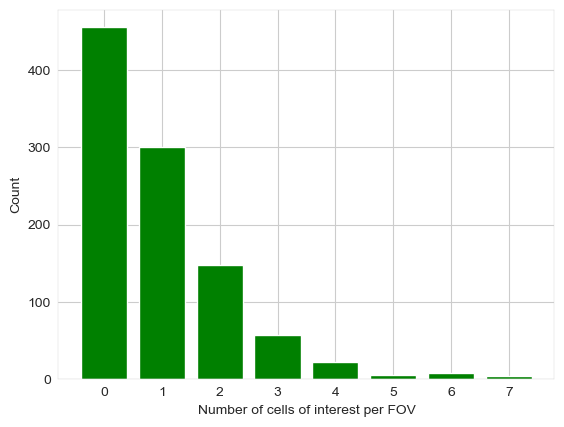

In [25]:
v = np.arange(0, max(values) + 1)
val_count = dict(zip(values, counts))
c = [val_count[i] if i in values else 0 for i in v]
plt.bar(v, c, color='g')
_ = plt.xticks(ticks=v)
plt.xlabel('Number of cells of interest per FOV')
plt.ylabel('Count')
plt.show()

In [26]:
def build_assignment_matrix(attribute_dict, n_cell_types):
    data = list(attribute_dict.items())
    data = np.array(data)  # Assignment matrix

    B = np.zeros((data.shape[0], n_cell_types))  # Empty matrix

    for i in range(0, data.shape[0]):
        t = int(data[i, 1])
        B[i, t] = 1

    return B

def calculate_FOV_size(sampling_frac, min_x, max_x, min_y, max_y):
    area = (max_x - min_x) * (max_y - min_y)
    sampling_area = sampling_frac * area
    FOV_dim = np.round(np.sqrt(sampling_area))
    return FOV_dim

def random_FOV(FOV_dim, df, min_x, max_x, min_y, max_y):
    x_start = np.random.randint(min_x, max_x - FOV_dim)
    y_start = np.random.randint(min_y, max_y - FOV_dim)
    
    x_filtered = df[(df['X'] > x_start) & (df['X'] < x_start + FOV_dim)]
    random_FOV = x_filtered[(x_filtered['Y'] > y_start) & (x_filtered['Y'] < y_start + FOV_dim)]
    
    return random_FOV

def calculate_p_in_fov(fov, n_cell_types):
    types_in_fov = fov['Cluster_remap'].astype(int).tolist()
    #print(types_in_fov)
    attribute_dict = dict(zip(fov.index, types_in_fov))
    B = build_assignment_matrix(attribute_dict, n_cell_types)
    return np.divide(np.sum(B, axis=0), B.shape[0])

def estimate_beta_from_FOV(df, fov_dim, type_of_interest, n_fov, x_min, x_max, y_min, y_max, n_cell_types):
    p_list = []
    i = 0
    ns = []
    while i < n_fov:
        fov = random_FOV(fov_dim, df, x_min, x_max, y_min, y_max)
        if len(fov) > 5:
            # because we don't define the boundary of the TISSUE just the boundary of the image
            # you could draw an fov out of tissue bounds but in the enclosing rectangle
            p_list.append(calculate_p_in_fov(fov, n_cell_types))
            ns.append(len(fov))
            i += 1
        else:
            continue
    print(ns)
    sample_proportions = np.vstack(p_list)
    props_of_interest = sample_proportions[:, type_of_interest]
    
    sample_mean = np.mean(props_of_interest)
    sample_var = np.var(props_of_interest)
    
    #print()
    alpha_hat = sample_mean * (((sample_mean*(1-sample_mean))/sample_var) - 1)
    beta_hat = (1 - sample_mean) * (((sample_mean*(1-sample_mean))/sample_var) - 1)

    return alpha_hat, beta_hat, props_of_interest, ns

def estimate_beta_from_FOV_ds(df, fov_dim, type_of_interest, n_fov, x_min, x_max, y_min, y_max, 
                           n_cell_types, target_size):
    p_list = []
    i = 0
    ns = []
    while i < n_fov:
        fov = random_FOV(fov_dim, df, x_min, x_max, y_min, y_max)
        if len(fov) == target_size:
            # because we don't define the boundary of the TISSUE just the boundary of the image
            # you could draw an fov out of tissue bounds but in the enclosing rectangle
            p_list.append(calculate_p_in_fov(fov, n_cell_types))
            ns.append(len(fov))
            i += 1
        elif len(fov) > target_size:
            #n_to_remove = len(fov) - target_size
            fov = fov.sample(n=target_size, replace=False)
            p_list.append(calculate_p_in_fov(fov, n_cell_types))
            ns.append(len(fov))
            i += 1
        else:
            continue
    #print(ns)
    sample_proportions = np.vstack(p_list)
    props_of_interest = sample_proportions[:, type_of_interest]
    
    sample_mean = np.mean(props_of_interest)
    sample_var = np.var(props_of_interest)
    
    #print()
    alpha_hat = sample_mean * (((sample_mean*(1-sample_mean))/sample_var) - 1)
    beta_hat = (1 - sample_mean) * (((sample_mean*(1-sample_mean))/sample_var) - 1)

    return alpha_hat, beta_hat, props_of_interest

def p_fov_with_rarest(a, b, m, N):
    return 1 - np.power((BF(a, b + m)/BF(a, b)), N)

def fov_cell_counts(df, fov_dim, toi, n_fov, x_min, x_max, y_min, y_max, n_cell_types, ret_n = False):
    
    p_list = []
    i = 0
    ns = []
    while i < n_fov:
        fov = random_FOV(fov_dim, df, x_min, x_max, y_min, y_max)
        if len(fov) > 10:
            types_in_fov = fov['Cluster_remap'].astype(int).tolist()
            #print(types_in_fov)
            attribute_dict = dict(zip(fov.index, types_in_fov))
            B = build_assignment_matrix(attribute_dict, n_cell_types)
            p_list.append(np.sum(B, axis=0))
            ns.append(len(fov))
            i += 1
        else:
            continue
        
    sample_counts = np.vstack(p_list)
    
    if ret_n == True:
        return sample_counts[:, toi].astype(int), np.sum(sample_counts, axis=1).astype(int)
    else:
        return sample_counts[:, toi].astype(int)
    
def convert_params(m, k):
    """ 
    Convert mean/dispersion parameterization of a negative binomial to the ones scipy supports

    Parameters
    ----------
    m : float 
       Mean
    k : float
       Overdispersion parameter. 
    """
    k = 1/k
    var = m + k * m ** 2
    p = (var - m) / var
    r = m ** 2 / (var - m)
    return r, 1-p

In [37]:
toi = 2
n_fov = 50

x_min = min(df['X'])
x_max = max(df['X'])
y_min = min(df['Y'])
y_max = max(df['Y'])
n_toi_observed, ns_r = fov_cell_counts(df, fov_size_5r, toi, n_fov, x_min, x_max, y_min, y_max, n_cell_types, ret_n=True)
props_of_interest = np.divide(n_toi_observed, ns_r)
sample_mean = np.mean(props_of_interest)
sample_var = np.var(props_of_interest)
alpha_hat_r = sample_mean * (((sample_mean*(1-sample_mean))/sample_var) - 1)
beta_hat_r = (1 - sample_mean) * (((sample_mean*(1-sample_mean))/sample_var) - 1)

x_min = min(df_ist['X'])
x_max = max(df_ist['X'])
y_min = min(df_ist['Y'])
y_max = max(df_ist['Y'])
n_toi_observed, ns_i = fov_cell_counts(df_ist, fov_size_5i, toi, n_fov, x_min, x_max, y_min, y_max, n_cell_types, ret_n=True)
props_of_interest = np.divide(n_toi_observed, ns_i)
sample_mean = np.mean(props_of_interest)
sample_var = np.var(props_of_interest)
alpha_hat_i = sample_mean * (((sample_mean*(1-sample_mean))/sample_var) - 1)
beta_hat_i = (1 - sample_mean) * (((sample_mean*(1-sample_mean))/sample_var) - 1)


In [43]:
np.mean(ns_r)

415.63457913893546

In [28]:
from scipy.stats import beta
import matplotlib.pyplot as plt
from scipy.stats import betabinom, binom

In [29]:
p_toi = len(df[df['Cluster_remap'] == 2])/len(df)
p_toi

0.0012688497389097653

In [ ]:
import matplotlib
from scipy.stats import binom
from matplotlib import cm, colors
import matplotlib.pyplot as plt

plt.clf()
matplotlib.rc_file_defaults()
matplotlib.rcParams.update({'axes.linewidth': 0.25,
                            'xtick.major.size': 2,
                            'xtick.major.width': 0.25,
                            'ytick.major.size': 2,
                            'ytick.major.width': 0.25,
                            'pdf.fonttype': 42,
                            'font.sans-serif': 'Helvetica'})

#sns.set_style("white")
fig, ax = plt.subplots(1, 1)
ax.spines['left'].set_color('k')
ax.spines['bottom'].set_color('k')
x = np.arange(0, 1500)
#ax.plot(x, betabinom.sf(0, x, alpha_hat_r, beta_hat_r), color = 'orange', lw = 3, label=r'osmFISH')
#ax.plot(x, betabinom.sf(0, x, alpha_hat_i, beta_hat_i), color = 'blue', linestyle='dashed', lw = 3, label=r'IST')
ax.plot(x, binom.sf(0, x, p=p_toi, color='green', lw=0.6,  label=r'Random/No Structure')
ax.set_xlabel(r'N cells')
ax.set_ylabel(r'Probability of discovering type of interest')
ax.set_ylim(0,1.05)
#plt.legend()
#plt.savefig('../fig/L6_discovery_singlecell_sampling_with_random.pdf')
plt.savefig('/Users/ethan/Desktop/megakaryocyte_binomial.pdf')
plt.show()

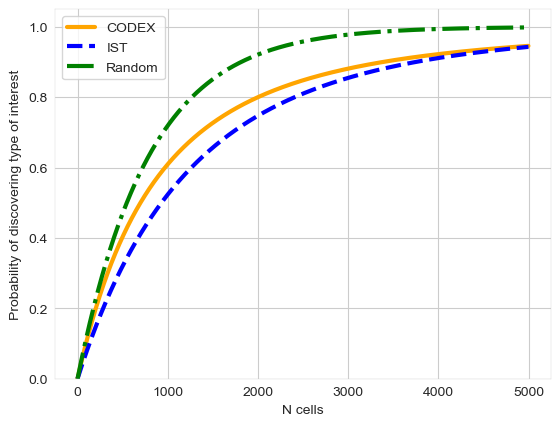

In [30]:
import matplotlib
from matplotlib import cm, colors
import matplotlib.pyplot as plt

matplotlib.rcParams.update({'axes.linewidth': 0.25,
                            'xtick.major.size': 2,
                            'xtick.major.width': 0.25,
                            'ytick.major.size': 2,
                            'ytick.major.width': 0.25,
                            'pdf.fonttype': 42,
                            'font.sans-serif': 'Arial'})

sns.set_style("whitegrid")
fig, ax = plt.subplots(1, 1)
x = np.arange(0, 5000)
ax.plot(x, betabinom.sf(0, x, alpha_hat_r, beta_hat_r), color = 'orange', lw = 3, label='CODEX')
ax.plot(x, betabinom.sf(0, x, alpha_hat_i, beta_hat_i), color = 'blue', linestyle='dashed', lw = 3, label='IST')
ax.plot(x, binom.sf(0,x,p=p_toi), color = 'green', linestyle='-.', lw = 3, label='Random')
ax.set_xlabel(r'N cells')
ax.set_ylabel(r'Probability of discovering type of interest')
ax.set_ylim(0,1.05)
plt.legend()
#plt.savefig('./megakaryocyte_discovery_singlecell_sampling_withRandom.pdf')
#plt.savefig('../fig/FigureS5A.pdf')
plt.show()

In [32]:
y = binom.sf(0,x,p=p_toi)
np.where(y>0.8)

(array([1268, 1269, 1270, ..., 4997, 4998, 4999]),)

### Estimate NB parameters

In [22]:
from scipy.stats import nbinom

In [23]:
def convert_params(m, k):
    """ 
    Convert mean/dispersion parameterization of a negative binomial to the ones scipy supports

    Parameters
    ----------
    m : float 
       Mean
    k : float
       Overdispersion parameter. 
    """
    k = 1/k
    var = m + k * m ** 2
    p = (var - m) / var
    r = m ** 2 / (var - m)
    return r, 1-p

#### Method of moments (better if not zero inflated)

In [24]:
xbar = np.mean(n_toi_observed)
x2bar = np.mean(n_toi_observed**2)

k = xbar**2/(x2bar - xbar**2 - xbar)
m = xbar

r, p = convert_params(m, k)

Text(0, 0.5, 'Count')

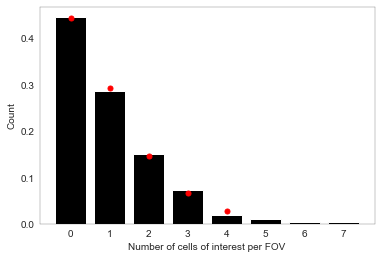

In [25]:
v = np.arange(0, max(values) + 1)
val_count = dict(zip(values, counts))
c = np.array([val_count[i] if i in values else 0 for i in v])
plt.bar(v, c/n_fov, color='k')
x = np.arange(nbinom.ppf(1e-5, r, p),
              nbinom.ppf(1-1e-2, r, p))
plt.plot(x, nbinom.pmf(x, r, p), 'ro', ms=5, label='nbinom pmf')

#_ = plt.xticks(ticks=v)
plt.xlabel('Number of cells of interest per FOV')
plt.ylabel('Count')

#### ZTM Fit (better for zero-inflated)

In [26]:
from scipy.optimize import fsolve

In [27]:
v = np.arange(0, max(values) + 1)
val_count = dict(zip(values, counts))
c = np.array([val_count[i] if i in values else 0 for i in v])

n0 = c[0]
N = np.sum(c)
p0 = n0/N
m = np.mean(n_toi_observed)

def f2(k, p0, m):
    return np.power((m/k + 1), -k) - p0

k = fsolve(f2, x0=1, args=(p0, m))
r, p = convert_params(m, k)

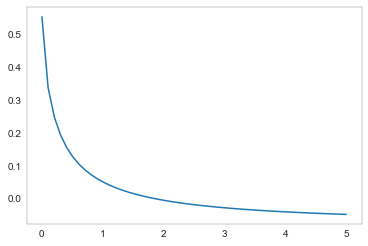

In [28]:
ks = np.linspace(1e-9, 5)
plt.plot(ks, f2(ks, p0, m))

In [29]:
k

array([1.84482402])

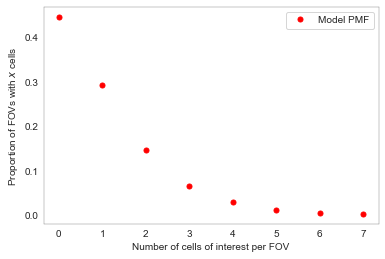

In [30]:
#plt.bar(v, c/n_fov, color='k', label = 'Emprical density')
x = np.arange(nbinom.ppf(1e-5, r, p),
              nbinom.ppf(1-1e-3, r, p))
plt.plot(x, nbinom.pmf(x, r, p), 'ro', ms=5, label='Model PMF')

#_ = plt.xticks(ticks=v)
plt.xlabel('Number of cells of interest per FOV')
plt.ylabel('Proportion of FOVs with $x$ cells')
plt.legend()
plt.savefig('./spleen_data/figures/empiricaldist_model_balbc1_type' + str(toi) + '.pdf')

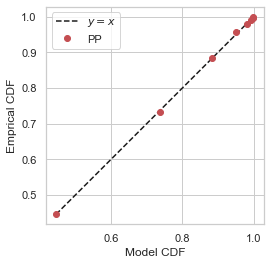

In [31]:
c_normed = c/n_fov
ecdf = np.cumsum(c_normed)
model_pmf = nbinom.pmf(x, r, p)
model_cdf = np.cumsum(model_pmf[:len(ecdf)])

xx = np.linspace(min(min(model_cdf), min(ecdf)),1)
sns.set(style='whitegrid')
plt.plot(xx, xx, 'k--', label = '$y=x$')
plt.plot(model_cdf, ecdf[:len(model_cdf)], 'ro', label='PP')
plt.xlabel('Model CDF')
plt.ylabel('Emprical CDF')
plt.gca().set_aspect('equal', adjustable='box')
plt.legend(frameon=True)
#plt.tight_layout()
#plt.savefig('./spleen_data/figures/emp_model_PP_type' + str(toi) + '.pdf')

### Construct FOV Plots

In [32]:
def do_model_trials(df, fov_size, toi, n_cell_types, n_fov, n_trials, estimator='ztm', guess = 0.2):
    
    x_min = min(df['X'])
    x_max = max(df['X'])
    y_min = min(df['Y'])
    y_max = max(df['Y'])

    trial_counter = 0
    
    def f2(k, p0, m):
            return np.power((m/k + 1), -k) - p0
    ns = np.arange(0,10)
    while trial_counter < n_trials:
        n_toi_observed = fov_cell_counts(df, fov_size, toi, n_fov, x_min, x_max, y_min, y_max, n_cell_types)
        values, counts = np.unique(n_toi_observed, return_counts=True)
        v = np.arange(0, max(values) + 1)
        val_count = dict(zip(values, counts))
        c = np.array([val_count[i] if i in values else 0 for i in v])
        
        #Method of moments estimation
        if estimator == 'mom':
            xbar = np.mean(n_toi_observed)
            x2bar = np.mean(n_toi_observed**2)

            k = xbar**2/(x2bar - xbar**2 - xbar)
            m = xbar
            r, p = convert_params(m, k)
        
            x = np.arange(0, 60)
            p0 = nbinom.pmf(0,r,p)
            if trial_counter == 0:
                res = nbinom.pmf(x, r, p)
                fov = p_discovery_in_n_fov(p0, ns)
            else:
                res = np.vstack((res, nbinom.pmf(x, r, p)))
                fov = np.vstack((fov, p_discovery_in_n_fov(p0, ns)))
            
        if estimator == 'ztm':
            #Parameter estimation with ZTM method
            n0 = c[0]
            N = np.sum(c)
            p0 = n0/N
            m = np.mean(n_toi_observed)
            k = fsolve(f2, x0=guess, args=(p0, m))
            r, p = convert_params(m, k)
        
            x = np.arange(0, 60)
            if trial_counter == 0:
                res = nbinom.pmf(x, r, p)
                fov = p_discovery_in_n_fov(p0, ns)
            else:
                res = np.vstack((res, nbinom.pmf(x, r, p)))
                fov = np.vstack((fov, p_discovery_in_n_fov(p0, ns)))
        trial_counter += 1 
    
    
    return res, fov

def p_discovery_in_n_fov(p0, n):
        return 1 - np.power(p0, n)
    
def calc_errs(arr, ci=0.95):
    means = np.mean(arr, axis = 0)
    std = np.std(arr, axis = 0)
    ci = stats.norm.ppf(0.95) * (std/np.sqrt(arr.shape[0]))
    return means, ci

In [34]:
#toi = 17
n_fov = 30
mode = 'ztm'

res_1r, fov_1r = do_model_trials(df, fov_size=fov_size_1r, toi=toi, n_cell_types=n_cell_types, n_fov=n_fov, n_trials = 100, estimator=mode)
res_5r, fov_5r = do_model_trials(df, fov_size=fov_size_5r, toi=toi, n_cell_types=n_cell_types, n_fov=n_fov, n_trials = 100, estimator=mode)
res_10r, fov_10r = do_model_trials(df, fov_size=fov_size_10r, toi=toi, n_cell_types=n_cell_types, n_fov=n_fov, n_trials = 100, estimator=mode)
res_05r, fov_05r = do_model_trials(df, fov_size=fov_size_05r, toi=toi, n_cell_types=n_cell_types, n_fov=n_fov, n_trials = 100, estimator=mode)

res_1i, fov_1i = do_model_trials(df_ist, fov_size=fov_size_1i, toi=toi, n_cell_types=n_cell_types, n_fov=n_fov, n_trials = 100,estimator=mode)
res_5i, fov_5i = do_model_trials(df_ist, fov_size=fov_size_5i, toi=toi, n_cell_types=n_cell_types, n_fov=n_fov, n_trials = 100,estimator=mode)
res_10i, fov_10i = do_model_trials(df_ist, fov_size=fov_size_10i, toi=toi, n_cell_types=n_cell_types, n_fov=n_fov, n_trials = 100,estimator=mode)
res_05i, fov_05i = do_model_trials(df_ist, fov_size=fov_size_05i, toi=toi, n_cell_types=n_cell_types, n_fov=n_fov, n_trials = 100,estimator=mode)

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
  warnings.warn(msg, RuntimeWarning)
/Users/ethan/anaconda3/envs/spatialdata/lib/python3.7/site-packages/scipy/optimize/minpack.py:175: RuntimeWarning: The iteration is not making good progress, as measured by the 
  improvement from the last ten iterations.
 

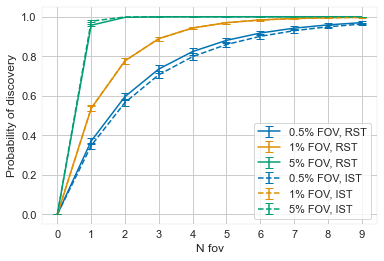

In [52]:
import matplotlib
from matplotlib import cm, colors
import matplotlib.pyplot as plt

matplotlib.rcParams.update({'axes.linewidth': 0.25,
                            'xtick.major.size': 2,
                            'xtick.major.width': 0.25,
                            'ytick.major.size': 2,
                            'ytick.major.width': 0.25,
                            'pdf.fonttype': 42,
                            'font.sans-serif': 'Arial'})

plt.clf()
ns = np.arange(0,10)
labels = [r'0.5% FOV, RST', r'1% FOV, RST', r'5% FOV, RST', r'10% FOV, RST',
          r'0.5% FOV, IST', r'1% FOV, IST', r'5% FOV, IST', r'10% FOV, IST']
arrs = [fov_05r, fov_1r, fov_5r, fov_10r, fov_05i, fov_1i, fov_5i, fov_10i]
sns.set_style('whitegrid')
#sns.set_context('paper')
for i in range(0, len(arrs)):
    mean, ci = calc_errs(arrs[i], ci=0.95)
    if i==3 or i==7:
        pass
    
    elif i < 4:
        plt.errorbar(ns, mean, yerr=ci, label=labels[i], color = sns.color_palette('colorblind')[i%4] ,capsize=4)
    else:
        plt.errorbar(ns, mean, yerr=ci, label=labels[i], linestyle='dashed', capsize=4, color = sns.color_palette('colorblind')[i%4])
        
    _ = plt.xticks(ticks=ns)
    plt.xlabel(r'N fov')
    plt.ylabel(r'Probability of discovery')
    plt.legend()
    #plt.tight_layout()
    #plt.savefig('./spleen_data/figures/nFOVs_cell'+str(toi)+'discovery_ci95.pdf')
    plt.savefig('./spleen_data/figures/Figure2F.pdf')